In [14]:
#Importing libraries
import torch
import torch.nn as nn
import torchvision
import torchvision.datasets as datasets
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader

In [17]:
!pip uninstall -q tensorboard tb-nightly
!pip install -q tb-nightly
%pylab inline
%load_ext tensorboard
import torch.utils.tensorboard as tb
import tempfile
log_dir=tempfile.mkdtemp()

Proceed (y/n)? y
     |████████████████████████████████| 6.0 MB 29.0 MB/s 
Populating the interactive namespace from numpy and matplotlib


In [33]:
%tensorboard --logdir {log_dir} --reload_interval 1

Output hidden; open in https://colab.research.google.com to view.

In [20]:
logger=tb.SummaryWriter(log_dir+'/test',flush_secs=1)

In [18]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [21]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [22]:
num_classes = 10
num_epochs = 1
batch_size = 128
learning_rate = 0.1

In [23]:
transform = transforms.Compose([
    transforms.Resize((227,227)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.4914, 0.4822, 0.4465], std=[0.229, 0.224, 0.225]),
])

train_data = torchvision.datasets.CIFAR10(root='./data', train=True, download=True, transform=transform)
train_loader = torch.utils.data.DataLoader(train_data, batch_size=128, shuffle=True, num_workers=2)

test_data = torchvision.datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)
test_loader = torch.utils.data.DataLoader(test_data, batch_size=128, shuffle=False, num_workers=2)

Files already downloaded and verified
Files already downloaded and verified


In [26]:
examples=iter(test_loader)
example_data, example_targets=examples.next()
img_grid=torchvision.utils.make_grid(example_data)
logger.add_image('cifar10_images',img_grid)

In [24]:
class AlexNetModel(nn.Module):
    def __init__(self, num_classes=10):
        super(AlexNetModel, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 96, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2)),  
            nn.MaxPool2d(kernel_size=3, stride=2), 
            nn.ReLU(inplace=True),
            nn.Conv2d(96, 256, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2)),
            nn.MaxPool2d(kernel_size=3, stride=2), 
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
            nn.ReLU(inplace=True),
            nn.Conv2d(384, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
            nn.ReLU(inplace=True),
            nn.Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1)),
            nn.MaxPool2d(kernel_size = 3, stride = 2),
            nn.ReLU(inplace=True)
        )

        self.classifier = nn.Sequential(
            nn.Dropout(0.5),
            nn.Linear(9216, 4096),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(4096, 1024),
            nn.ReLU(inplace=True),
            nn.Linear(1024, num_classes),
        )

    def forward(self, x):
        x = self.features(x)
        h = x.view(x.shape[0], -1)
        x = self.classifier(h)
        return x


In [28]:
model = AlexNetModel(num_classes).to(device)
cost = nn.CrossEntropyLoss()
optimizer = optim.SGD(model.parameters(), lr=learning_rate)  
total_step = len(train_loader)

In [29]:
StepsPerEpoch = total_step//batch_size
StepsPerTestEpoch=len(test_loader)//batch_size
loss_in_testing = []
accuracy_in_testing = []
loss_in_training = []
accuracy_in_training = []
loss_history = []
accuracy_history=[]

In [30]:
logger.add_graph(model,example_data)

In [32]:
#Training loop
total_step = len(train_loader)
running_loss=0.0
running_correct=0.0
for epoch in range(num_epochs):
    for i, (images, labels) in enumerate(train_loader):  
        images = images.to(device)
        labels = labels.to(device)
        
        outputs = model(images)
        loss = cost(outputs, labels)
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        loss_history.append(loss.item()/batch_size)
        total=0
        total+=labels.size(0)

        running_loss+=loss.item()
        _, predicted = torch.max(outputs.data, 1)
        running_correct+=(predicted == labels).sum().item()
        accuracy_history.append(running_correct/total*100)
    
        if (i+1) % 10 == 0:
            print ('Epoch [{}/{}], Step [{}/{}], Loss: {:.4f}' 
                        .format(epoch+1, num_epochs, i+1, total_step, loss.item()))
            logger.add_scalar('training loss',running_loss/400, epoch*total_step+i)
            logger.add_scalar('Accuracy',running_correct/400, epoch*total_step+i)
            running_loss=0.0
            running_correct=0

    loss_in_training.append(sum(loss_history[-StepsPerEpoch:]) / StepsPerEpoch)
    accuracy_in_training.append(sum(accuracy_history[-StepsPerEpoch:]) / StepsPerEpoch)

Epoch [1/1], Step [10/391], Loss: 2.3022
Epoch [1/1], Step [20/391], Loss: 2.3016
Epoch [1/1], Step [30/391], Loss: 2.3037
Epoch [1/1], Step [40/391], Loss: 2.3034
Epoch [1/1], Step [50/391], Loss: 2.3016
Epoch [1/1], Step [60/391], Loss: 2.3020
Epoch [1/1], Step [70/391], Loss: 2.3034
Epoch [1/1], Step [80/391], Loss: 2.2955
Epoch [1/1], Step [90/391], Loss: 2.2932
Epoch [1/1], Step [100/391], Loss: 2.2886
Epoch [1/1], Step [110/391], Loss: 2.2373
Epoch [1/1], Step [120/391], Loss: 2.2587
Epoch [1/1], Step [130/391], Loss: 2.1549
Epoch [1/1], Step [140/391], Loss: 2.1437
Epoch [1/1], Step [150/391], Loss: 2.2192
Epoch [1/1], Step [160/391], Loss: 2.2968
Epoch [1/1], Step [170/391], Loss: 2.1984
Epoch [1/1], Step [180/391], Loss: 2.1588
Epoch [1/1], Step [190/391], Loss: 2.1392
Epoch [1/1], Step [200/391], Loss: 2.0490
Epoch [1/1], Step [210/391], Loss: 2.2334
Epoch [1/1], Step [220/391], Loss: 2.0248
Epoch [1/1], Step [230/391], Loss: 2.1626
Epoch [1/1], Step [240/391], Loss: 2.0242
E

In [37]:
y_pred=[]
y_true=[]
with torch.no_grad():
    correct = 0
    total = 0
    test_loss=0
    for images, labels in test_loader:
        images = images.to(device)
        labels = labels.to(device)
        outputs = model(images)
        loss=cost(outputs,labels)
        test_loss+=loss.item()
        _, predicted = torch.max(outputs.data, 1)
        predicted = predicted.data.cpu()
        y_pred.extend(list(predicted.numpy()))
        y_true.extend(list(labels.numpy()))
        total += labels.size(0)
        correct += (predicted == labels).sum().item()
        loss_in_testing.append(test_loss)
        del images, labels, outputs

    print('Accuracy of the network on the {} test images: {} %'.format(10000, 100 * correct / total))

Accuracy of the network on the 10000 test images: 34.12 %


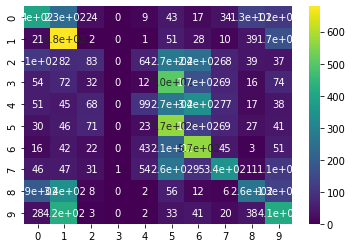

In [38]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns
from sklearn.metrics import confusion_matrix, plot_confusion_matrix
table=pd.DataFrame(confusion_matrix(y_true, y_pred, labels=np.arange(0,10)))
sns.heatmap(table, annot=True, cmap='viridis')

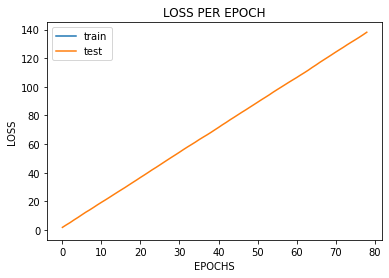

In [39]:
plt.plot(loss_in_training,label="train")
plt.plot(loss_in_testing,label='test')
plt.title('LOSS PER EPOCH')
plt.xlabel("EPOCHS")
plt.ylabel("LOSS")
plt.legend()
plt.show()